<h1 style="text-align: center;">Interview Question </h1>
<h2 style="text-align: center;">Data Preparation</h2>

### Download the full dataset :
### If you already have it don't run these cells, just copy the folder 'FullIJCNN2013' in the folder of this notebook

In [86]:
import urllib
import zipfile

opener = urllib.request.URLopener()
# This may take some time ...
opener.retrieve('http://benchmark.ini.rub.de/Dataset_GTSDB/FullIJCNN2013.zip', 'FullIJCNN2013.zip')
zip_file = zipfile.ZipFile('./FullIJCNN2013.zip', 'r')


KeyboardInterrupt: 

In [ ]:
zip_file.extractall('./')
zip_file.close()

### Requirements :
To run the cells of the notebook you may need to install pandas, scikit-image and opencv :
if you are using python 3.x :

```` sh
pip install scikit-image  
pip install pandas
pip install opencv-python
````
If you are using anaconda or miniconda:
````sh
conda install -c conda-forge scikit-image
conda install pandas

````
Unfortunately, I did not find any (reliable) command to install opencv with anaconda using conda...

### Set Up Environment :

In [38]:
import os, sys

os.mkdir('generated')
os.mkdir('generated/flip')
os.mkdir('generated/rotate')
os.mkdir('generated/scale')
os.mkdir('generated/translate')
os.mkdir('generated/final')
os.mkdir('generated/noise')
os.mkdir('test')
os.mkdir('train')




FileExistsError: [WinError 183] Impossible de créer un fichier déjà existant: 'generated'

### Load the data :

Metadata are stored in a csv file called "gt.txt". The first cell is the image filename, the 2nd and the 3rd cells corresponds to the coordinates of the higher left  corner of the bounding box, the 4th and the 5th cells corresponds to the coordinates of the lower right corner of the bounding box. 
I use pandas to load the whole file as a DataFrame.

In [1]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import copy as cp
data = pd.read_csv('./FullIJCNN2013/gt.txt', sep=";", header=None)
data.columns = ["img", "x1", "y1", "x2", "y2","id"]

The dataset includes 4 differents categories : prohibitory,danger and mandatory. Since we only want to detect red circle traffic signs (i.e. prohibitory) we have to select the "right ids". The ids (i.e. subcategories) corresponding to prohibitory traffic signs are 0,1,2,3,4,5,6,7,8,9,10,15 and 16. Once we have selected the right data we only have 392 images left. Hence, the dataset is quite small. Indeed, NNs usually require several thousands of images for training.

To fix this "size problem" we have to generate images from the images provided in this dataset. This process is called data augmentation.

In [2]:
import os
import cv2 
from PIL import Image
classes = [0,1,2,3,4,5,6,7,8,9,10,15,16]
usable_data = data[data.id.isin(classes)]
set_size = len(usable_data.groupby('img'))
print('We have ',set_size,' usable images')


We have  392  usable images


### Data Augmentation

There are several ways of artificially generate images. I am only going to use a few of them here.

#### Flipping :
The idea is to flip vertically and or horizontally the images. Flipping our images vertically would not make any sense here but horizontally flipping the images would be useful and can double the size of our dataset.

In [3]:
def draw_bb(im,bb):
    cv2.rectangle(im,(bb[0],bb[1]),(bb[2],bb[3]),(0,255,0),3)
    return im

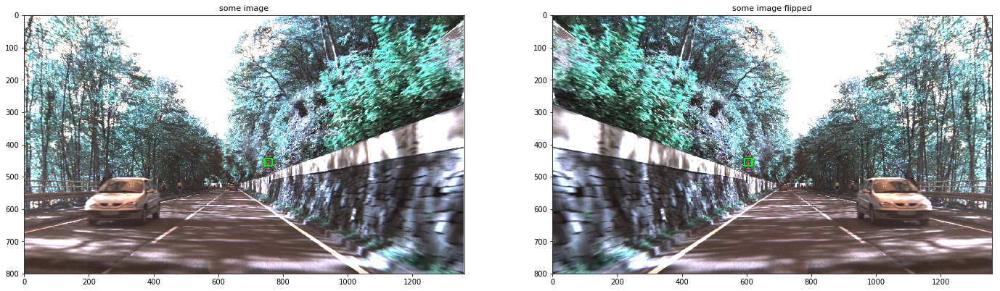

In [8]:
im = cv2.imread('./FullIJCNN2013/'+usable_data.iloc[0]['img'])
im_flip = im.copy()
im_flip = cv2.flip(im_flip,1)
draw_bb(im,[usable_data.iloc[0]['x1'],usable_data.iloc[0]['y1'],usable_data.iloc[0]['x2'],usable_data.iloc[0]['y2']])
draw_bb(im_flip,[int(im_flip.shape[1]-usable_data.iloc[0]['x1']-1),usable_data.iloc[0]['y1'],
                           int(im_flip.shape[1]-usable_data.iloc[0]['x2']-1),usable_data.iloc[0]['y2']])


cv2.imwrite('ex0.jpg',im)

cv2.imwrite('ex1.jpg',im_flip)

plt.figure(figsize=(50,50))
plt.subplot(1,4,1),plt.imshow(im),plt.title('some image',fontsize=11)
plt.subplot(1,4,2),plt.imshow(im_flip),plt.title('some image flipped',fontsize=11)
plt.show()

In [10]:

def flip_data(df,src,dst,version):
    """
    Generate fliped images
    
    Parameters
    ----------
    df : pd.DataFrame
        input dataset used
    src : str 
        input pictures folder path
    dst : str 
        output pictures folder path
    version : str
        version of output pictures
    
    Returns
    -------
    pd.DataFrame
        DataFrame of the output dataset

    """
    do = pd.DataFrame()
    for name, group in df.groupby('img'):
        im_name,file_extension = os.path.splitext(name)
        out_name = im_name+version+'Flip.jpg'
        im = cv2.imread(src+name)
        im_flip = cp.deepcopy(im)
        # Flip input image
        im_flip = cv2.flip(im_flip,1)
        cv2.imwrite(dst+out_name,im_flip)
        for index,el in group.iterrows():
            do = do.append(pd.DataFrame([[out_name,im_flip.shape[1]-el.x1-1,el.y1,im_flip.shape[1]-el.x2-1,el.y2,el.id]],
                                       columns=["img", "x1", "y1", "x2", "y2","id"]))
            
    return do
data_flip = flip_data(usable_data,'./FullIJCNN2013/','./generated/flip/',version='')

#### Rotation :

This technique is similar to the first technique. Here, we rotate all the images (flipped images included) by +/- 10°.

Lots of python libraries implement an image rotation function but only a few of them integrate an interpolation algorithm. Scikit-image transform.rotate function implements both the rotation and the interpolation. This feature allows us to generate images without a black background or without rescaling them.  I choose a reflect interpolation in order to keep some continuity in the background. It works well for pictures in natural environment such as the following pictures.

Running these cells may take a bit of time.

In [11]:
import skimage
from skimage import img_as_uint
import math

def rotate_data(df,src,dst,version,angle=10):
    """
    Generate rotated images
    
    Parameters
    ----------
    df : pd.DataFrame
        input dataset used
    src : str 
        input pictures folder path
    dst : str 
        output pictures folder path
    version : str
        version of output pictures
    angle : int
        rotation angle
    
    Returns
    -------
    pd.DataFrame
        DataFrame of the output dataset

    """
    do = pd.DataFrame()
    for name, group in df.groupby('img'):
        im_name,file_extension = os.path.splitext(name)
        sign_not_croped = True
        im = cv2.imread(src+name,cv2.IMREAD_COLOR)
        im_out = cp.deepcopy(im)
        out_name = im_name+version+'.jpg'
        width = im.shape[1]
        height = im.shape[0]
        dtemp = pd.DataFrame()
        for index,el in group.iterrows():
            x1 = el.x1 - (width)/2
            x2 = el.x2 - (width)/2
            y1 = el.y1 - (height)/2
            y2 = el.y2 - (height)/2
            cos = np.cos(np.deg2rad(angle))
            sin = -np.sin(np.deg2rad(angle))
            x1_new = int(x1*cos - y1*sin+(width)/2)
            x2_new = int(x2*cos - y2*sin+(width)/2)
            y1_new = int((height)/2 + (x1*sin+y1*cos))
            y2_new = int((height)/2 + (x2*sin+y2*cos))
            if(y1_new >= height or y2_new >= height or x1_new >= width or x2_new >= width 
               or y1_new < 0 or y2_new < 0 or x1_new < 0 or x2_new < 0):
                sign_not_croped = False
                break
            else:
                dtemp = dtemp.append(pd.DataFrame([[out_name,x1_new,y1_new,x2_new,y2_new,el.id]],
                                       columns=["img", "x1", "y1", "x2", "y2","id"]))
        #if one of the bounding box is croped don't keep the rotated image
        if(sign_not_croped):
            # apply rotation
            rot = skimage.transform.rotate(im_out, angle=angle, mode='reflect')
            do = do.append(dtemp)
            rot *= 255/(rot.max())
            rot = rot.astype(np.uint8)
            cv2.imwrite(dst+out_name,rot)

    return do
# Generate 10° rotated images
d_rotate = rotate_data(usable_data,'./FullIJCNN2013/','./generated/rotate/',version='Rot',angle = 10)
# Generate fliped and 10° rotated images
d_rotateFlip = rotate_data(data_flip,'./generated/flip/','./generated/rotate/',version='Rot',angle = 10)



In [12]:
# Generate 10° rotated images
d_rotate_neg = rotate_data(usable_data,'./FullIJCNN2013/','./generated/rotate/',version='RotNeg',angle = -10)
# Generate 
d_rotateFlip_neg = rotate_data(data_flip,'./generated/flip/','./generated/rotate/',version='RotNeg',angle = -10)


img    00004Rot.jpg
x1              903
y1              367
x2              961
y2              410
id                2
Name: 0, dtype: object


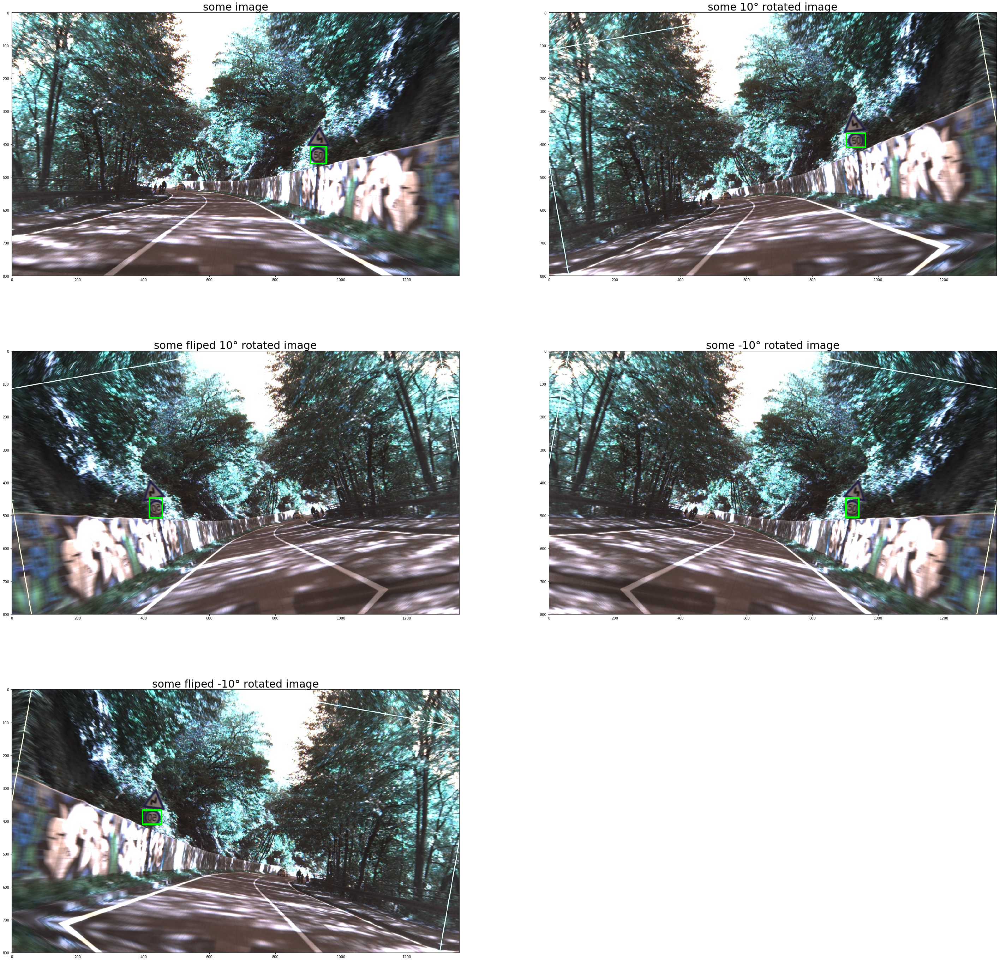

,img,x1,y1,x2,y2,id
0,00003Rot.jpg,748,431,775,450,4
0,00003Rot.jpg,752,454,778,473,9
0,00004Rot.jpg,903,367,961,410,2
0,00005Rot.jpg,1123,82,1253,174,9
0,00006Rot.jpg,913,308,986,360,2


In [14]:
im = cv2.imread('./FullIJCNN2013/'+usable_data.iloc[2]['img'],cv2.IMREAD_COLOR)
name,ext =os.path.splitext(usable_data.iloc[2]['img'])
im_r_data = d_rotate[d_rotate['img']==name+'Rot.jpg'].iloc[0]
im_r_data_f = d_rotateFlip[d_rotateFlip['img']==name+'FlipRot.jpg'].iloc[0]
im_r_data_n = d_rotate_neg[d_rotate_neg['img']==name+'RotNeg.jpg'].iloc[0]
im_r_data_fn = d_rotateFlip_neg[d_rotateFlip_neg['img']== name+'FlipRotNeg.jpg'].iloc[0] 


print(im_r_data)
im_r = cv2.imread('./generated/rotate/'+im_r_data['img'],cv2.IMREAD_COLOR)
im_r_f = cv2.imread('./generated/rotate/'+im_r_data_f['img'],cv2.IMREAD_COLOR)
im_r_n =cv2.imread('./generated/rotate/'+im_r_data_n['img'],cv2.IMREAD_COLOR)
im_r_fn = cv2.imread('./generated/rotate/'+im_r_data_fn['img'],cv2.IMREAD_COLOR)

draw_bb(im,[usable_data.iloc[2]['x1'],usable_data.iloc[2]['y1'],usable_data.iloc[2]['x2'],usable_data.iloc[2]['y2']])

draw_bb(im_r,[im_r_data['x1'],im_r_data['y1'],im_r_data['x2'],im_r_data['y2']])

draw_bb(im_r_f,[im_r_data_f['x1'],im_r_data_f['y1'],im_r_data_f['x2'],im_r_data_f['y2']])

draw_bb(im_r_n,[im_r_data_n['x1'],im_r_data_n['y1'],im_r_data_n['x2'],im_r_data_n['y2']])

draw_bb(im_r_fn,[im_r_data_fn['x1'],im_r_data_fn['y1'],im_r_data_fn['x2'],im_r_data_fn['y2']])

cv2.imwrite('ex2.jpg',im_r)

plt.figure(figsize=(50,50))
plt.subplot(3,2,1),plt.imshow(im),plt.title('some image',fontsize=30)
plt.subplot(3,2,2),plt.imshow(im_r),plt.title('some 10° rotated image',fontsize=30)
plt.subplot(3,2,3),plt.imshow(im_r_f),plt.title('some fliped 10° rotated image',fontsize=30)
plt.subplot(3,2,4),plt.imshow(im_r_n),plt.title('some -10° rotated image',fontsize=30)
plt.subplot(3,2,5),plt.imshow(im_r_fn),plt.title('some fliped -10° rotated image',fontsize=30)
plt.show()
d_rotate.head()


In [15]:
import os.path
path ='./generated/rotate'
num_files1 = len([f for f in os.listdir(path) if os.path.isfile(os.path.join(path, f))])
print(num_files1)
path ='./generated/flip'
num_files2 = len([f for f in os.listdir(path)if os.path.isfile(os.path.join(path, f))])
print(num_files1+num_files2)


1568
1960


Thanks to flipping and rotations we generated almost 2000 images. 

#### Scaling :

The idea is to resize the images so that the model can be trained with image of different sizes. Since the images are already big we can scale them in with a factor 0.5 without making the traffic sign undetectable.

In [83]:
def scale_data(df,src,dst,version,factor=0.5):
    """ 
    Generate rescaled images
    
    Parameters
    ----------
    df : pd.DataFrame
        input dataset used
    src : str 
        input pictures folder path
    dst : str 
        output pictures folder path
    version : str
        version of output pictures
    factor : float
        scale factor
    Returns
    -------
    pd.DataFrame
        DataFrame of the output dataset

    """
    do = pd.DataFrame()
    for name, group in df.groupby('img'):
        im_name,file_extension = os.path.splitext(name)
        im = cv2.imread(src+name,cv2.IMREAD_COLOR)
        im_out = cp.deepcopy(im)
        out_name = im_name+version+'.jpg'
        width = im.shape[1]
        height = im.shape[0]
        dtemp = pd.DataFrame()
        for index,el in group.iterrows():
            x1 = int( el.x1 * factor)
            x2 = int(el.x2 * factor)
            y1 = int(el.y1 * factor)
            y2 = int(el.y2 * factor)
            dtemp = dtemp.append(pd.DataFrame([[out_name,x1,y1,x2,y2,el.id]],
                                              columns=["img", "x1", "y1", "x2", "y2","id"]))
            im_out = skimage.transform.rescale(im_out, scale=factor,mode='constant',multichannel=True)
            do = do.append(dtemp)
            im_out *= 255/(im_out.max())
            im_out = im_out.astype(np.uint8)
            cv2.imwrite(dst+out_name,im_out)

    return do



In [84]:
d_scale_demi = scale_data(usable_data,'./FullIJCNN2013/','./generated/scale/',version='Scale0.5',factor=0.5)


c:\users\paul pc\appdata\local\programs\python\python36\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "


In [85]:
d_scale_2 = scale_data(usable_data,'./FullIJCNN2013/','./generated/scale/',version='Scale1.2',factor=1.2)

img    00004Scale0.5.jpg
x1                   453
y1                   203
x2                   477
y2                   229
id                     2
Name: 0, dtype: object


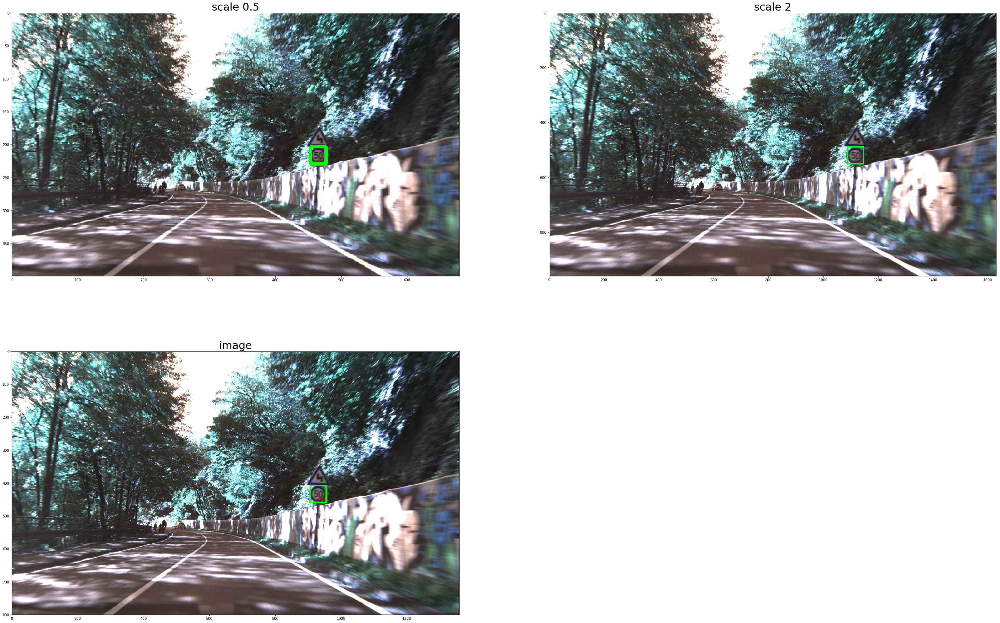

In [24]:

im = cv2.imread('./FullIJCNN2013/'+usable_data.iloc[2]['img'],cv2.IMREAD_COLOR)

name,ext =os.path.splitext(usable_data.iloc[2]['img'])
im_scale_demi_d = d_scale_demi[d_scale_demi['img']==name+'Scale0.5.jpg'].iloc[0]
im_scale_2_d = d_scale_2[d_scale_2['img']==name+'Scale1.2.jpg'].iloc[0] 
print(im_scale_demi_d)
im_scale_demi = cv2.imread('./generated/scale/'+im_scale_demi_d['img'],cv2.IMREAD_COLOR)
im_scale_2 = cv2.imread('./generated/scale/'+im_scale_2_d['img'],cv2.IMREAD_COLOR)



draw_bb(im,[usable_data.iloc[2]['x1'],usable_data.iloc[2]['y1'],usable_data.iloc[2]['x2'],usable_data.iloc[2]['y2']])

draw_bb(im_scale_2,[im_scale_2_d['x1'],im_scale_2_d['y1'],im_scale_2_d['x2'],im_scale_2_d['y2']])

draw_bb(im_scale_demi,[im_scale_demi_d['x1'],im_scale_demi_d['y1'],im_scale_demi_d['x2'],im_scale_demi_d['y2']])


plt.figure(figsize=(50,50))
plt.subplot(3,2,1),plt.imshow(Image.fromarray(im_scale_demi)),plt.title('scale 0.5',fontsize=30)
plt.subplot(3,2,2),plt.imshow(im_scale_2),plt.title('scale 2',fontsize=30)
plt.subplot(3,2,3),plt.imshow(im),plt.title('image',fontsize=30)
plt.show()

In [26]:
path ='./generated/rotate'
num_files1 = len([f for f in os.listdir(path) if os.path.isfile(os.path.join(path, f))])
# print(num_files1)
path ='./generated/flip'
num_files2 = len([f for f in os.listdir(path)if os.path.isfile(os.path.join(path, f))])
# print(num_files1+num_files2)
path ='./generated/scale'
num_files3 = len([f for f in os.listdir(path)if os.path.isfile(os.path.join(path, f))])
print('we generated ', num_files1+num_files2+num_files3,' images')


we generated  2744  images


### Translation :

Here we randomly translate the image on the Y and the X axis. The padding values are computing with the function numpy.random.randint based on ranges given by the user.

<function matplotlib.pyplot.show(*args, **kw)>

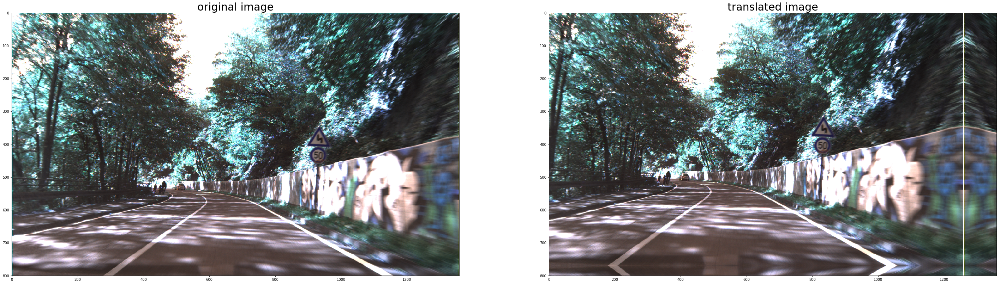

In [27]:
from skimage import transform as tf
im = cv2.imread('./FullIJCNN2013/'+usable_data.iloc[2]['img'],cv2.IMREAD_COLOR)
width = im.shape[1]
height = im.shape[0]
channels = 3
tform = tf.SimilarityTransform(scale=1, rotation=0,translation=(100,30))

out_im = tf.warp(im, tform,mode='reflect')
out_im*=255/(out_im.max())
out_im = out_im.astype(np.uint8)



plt.figure(figsize=(50,50))
plt.subplot(3,2,1),plt.imshow(Image.fromarray(im)),plt.title('original image',fontsize=30)
plt.subplot(3,2,2),plt.imshow(Image.fromarray(out_im)),plt.title('translated image',fontsize=30)
plt.show



In [49]:

def trans_data(df,src,dst,version,range_x=(-100,100),range_y=(-100,100)):
    """ 
    Parameters
    ----------
    df : pd.DataFrame
        input dataset used
    src : str 
        input pictures folder path
    dst : str 
        output pictures folder path
    version : str
        version of output pictures
    range_x : tuple
        range of x padding
    range_y : tuple
        range of y padding
    
    Returns
    -------
    pd.DataFrame
        DataFrame of the output dataset

    """
    do = pd.DataFrame()
    for name, group in df.groupby('img'):
        pad_x = np.random.randint(range_x[0],range_x[1])
        pad_y = np.random.randint(range_y[0],range_y[1])

        im_name,file_extension = os.path.splitext(name)
        sign_not_croped = True
        im = cv2.imread(src+name,cv2.IMREAD_COLOR)
        im_out = cp.deepcopy(im)
        out_name = im_name+version+'.jpg'
        width = im.shape[1]
        height = im.shape[0]
        dtemp = pd.DataFrame()
        bb_not_crop = True
        for index,row in group.iterrows():
            x1_new = row.x1-pad_x
            x2_new = row.x2-pad_x
            y1_new = row.y1-pad_y
            y2_new = row.y2-pad_y
            if(y1_new >= height or y2_new >= height or x1_new >= width or x2_new >= width 
               or y1_new < 0 or y2_new < 0 or x1_new < 0 or x2_new < 0):
                sign_not_croped = False
                break
            else:
                dtemp = dtemp.append(pd.DataFrame([[out_name,x1_new,y1_new,x2_new,y2_new,row.id]],
                                       columns=["img", "x1", "y1", "x2", "y2","id"]))
         #if one of the bounding box is croped don't keep the rotated image
        if(sign_not_croped):
            do = do.append(dtemp)
            # compute the similarity matrix for the translation
            tform = tf.SimilarityTransform(scale=1, rotation=0,translation=(pad_x,pad_y))    
            # apply the translation
            out_im = tf.warp(im, tform,mode='reflect')# use reflect interpolation for the missing parts
            # Sk transformed images need to be normalized 
            out_im*=255/(out_im.max())
            out_im = out_im.astype(np.uint8)
            cv2.imwrite(dst+out_name,out_im)    
    return do

In [30]:
trans_df = trans_data(usable_data,'./FullIJCNN2013/','./generated/translate/','Trans')


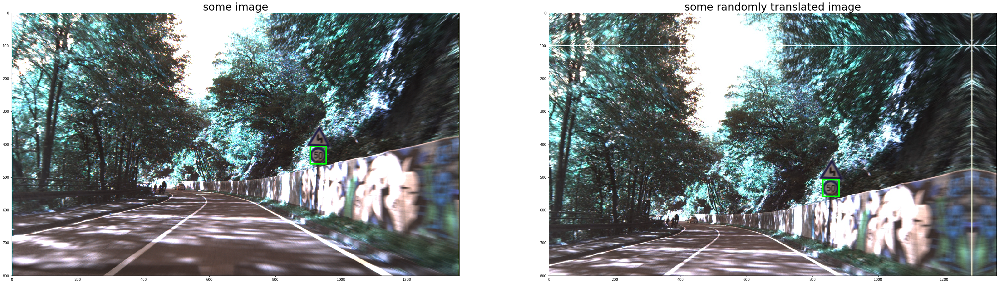

In [32]:
im = cv2.imread('./FullIJCNN2013/'+usable_data.iloc[2]['img'],cv2.IMREAD_COLOR)
name,ext =os.path.splitext(usable_data.iloc[2]['img'])
im_t_dat =trans_df[trans_df['img']==name+'Trans.jpg'].iloc[0] 


im_t = cv2.imread('./generated/translate/'+im_t_dat['img'],cv2.IMREAD_COLOR)

draw_bb(im,[usable_data.iloc[2]['x1'],usable_data.iloc[2]['y1'],usable_data.iloc[2]['x2'],usable_data.iloc[2]['y2']])

draw_bb(im_t,[im_t_dat['x1'],im_t_dat['y1'],im_t_dat['x2'],im_t_dat['y2']])

cv2.imwrite('ex3.jpg',im_t)

plt.figure(figsize=(50,50))
plt.subplot(3,2,1),plt.imshow(im),plt.title('some image',fontsize=30)
plt.subplot(3,2,2),plt.imshow(im_t),plt.title('some randomly translated image',fontsize=30)
plt.show()

### Noise

In [64]:
def add_noise(df,src,dst,version,sigma=10):
    do = pd.DataFrame()
    for name, group in df.groupby('img'):
        im_name,file_extension = os.path.splitext(name)
#         sign_not_croped = True
        im = cv2.imread(src+name,cv2.IMREAD_COLOR)
        im_out = cp.deepcopy(im)
        out_name = im_name+version+'.jpg'
        gauss = np.random.normal(0,sigma,(im_out.shape[0],im_out.shape[1],3))
        gauss = gauss.reshape(im_out.shape[0],im_out.shape[1],3)
        im_out = im_out+gauss
        cv2.imwrite(dst+out_name,im_out)    
        for index, row in group.iterrows():
            do = do.append(pd.DataFrame([[out_name,row.x1,row.y1,row.x2,row.y2,row.id]],
                                   columns=["img", "x1", "y1", "x2", "y2","id"]))
    return do
    

In [65]:
data_noise = add_noise(usable_data,'./FullIJCNN2013/',dst='./generated/noise/',version='Noise')
# usable_data.head()

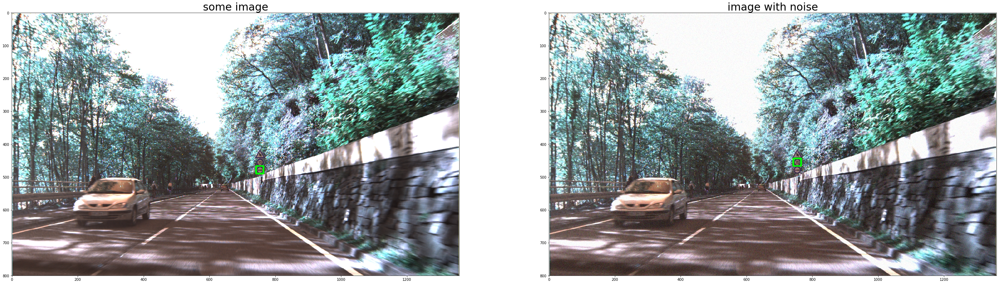

,img,x1,y1,x2,y2,id
0,00003Noise.jpg,742,443,765,466,4
0,00003Noise.jpg,742,466,764,489,9
0,00004Noise.jpg,906,407,955,459,2
0,00005Noise.jpg,1172,164,1284,278,9
0,00006Noise.jpg,926,350,989,414,2


In [79]:

im = cv2.imread('./FullIJCNN2013/'+usable_data.iloc[1]['img'],cv2.IMREAD_COLOR)

name,ext =os.path.splitext(usable_data.iloc[1]['img'])
noisy_data= data_noise[data_noise['img']==name+'Noise.jpg'].iloc[0]

im_noise = cv2.imread('./generated/noise/'+noisy_data['img'])

draw_bb(im,[usable_data.iloc[1]['x1'],usable_data.iloc[1]['y1'],usable_data.iloc[1]['x2'],usable_data.iloc[1]['y2']])

draw_bb(im_noise,[noisy_data['x1'],noisy_data['y1'],noisy_data['x2'],noisy_data['y2']])

cv2.imwrite('ex4.jpg',im_noise)

plt.figure(figsize=(50,50))
plt.subplot(1,2,1),plt.imshow(im),plt.title('some image',fontsize=30)
plt.subplot(1,2,2),plt.imshow(im_noise),plt.title('image with noise',fontsize=30)
plt.show()

data_noise.head()

### Creation of test set & training set

In [35]:
def data_split(df):
    msk = np.random.rand(len(df)) < 0.8
    train = df[msk]
    test = df[~msk]
    return train, test

In [86]:
from shutil import copyfile
import os
def create_dir(df,src,dst):
    """
    Copy all the images from dst in convert them in jpeg in dst directory
    
    Parameters
    ----------
    df : pd.DataFrame
        input dataset used
    src : str 
        input pictures folder path
    dst : str 
        output pictures folder path
    
    """
    do = cp.deepcopy(df)
    for index, row in do.iterrows():
        im_name, file_extension = os.path.splitext(row["img"])
        if(file_extension!='.jpg'):
            out_name = im_name+'.jpg'
            im = Image.open(src+row["img"])
            im.save(dst+out_name)
            do.at[index, 'img']=out_name
        else:
            im = Image.open(src+row["img"])
            im.save(dst+row["img"])
    return do

d_rotate_fin = d_rotate.append(d_rotate_neg.append(d_rotateFlip.append(d_rotateFlip_neg)))
d_scale_fin = d_scale_demi.append(d_scale_2)

# group all of the pictures :  generated + original pictures in './generated/final'
data_rotate_cp  = create_dir(d_rotate_fin,'./generated/rotate/','./generated/final/') 
data_flip_cp = create_dir(data_flip,'./generated/flip/','./generated/final/')
data_scale_cp = create_dir(d_scale_fin,'./generated/scale/','./generated/final/')
data_trans_cp = create_dir(trans_df,'./generated/translate/','./generated/final/')
orig_data_cp = create_dir(usable_data,'./FullIJCNN2013/','./generated/final/')
noise_data_cp = create_dir(data_noise,'./generated/noise/','./generated/final/')


In [87]:
# Divide the dataset for cross validation
aug_data = data_rotate_cp.append(data_flip_cp.append(data_scale_cp.append(data_trans_cp.append(orig_data_cp.
                                                                                               append(noise_data_cp)))))
train,test = data_split(aug_data)

train_cp = create_dir(train,'./generated/final/','./train/')
test_cp = create_dir(test,'./generated/final/','./test/')

In [82]:
# Create train.csv and test.csv

train_cp.to_csv('train.csv',sep=";", header=None, index=False)
test_cp.to_csv('test.csv',sep=";", header=None, index=False)
